# IPBME6UE: Problem Set 2 - Medical Image Processing

## Spring 2024

## Group Members

**Person 1:**

Scripnic Dinu


### Welcome to Problem Set 2!

In this problem set, we will be exploring some fundamental concepts in digital image processing. We will be also be doing some math! Luckily, iPython notebooks have the additional ability of interpreting LaTeX ($\LaTeX$) for typesetting mathematical expressions. For example:

$$ f(t)*g(t) = \int_{-\infty}^{\infty} f(\tau)g(t-\tau)d\tau $$

This says that a convolution is defined as the integral of the product of the two functions after one is reversed and shifted. Note the word reversed, as in the kernel is mirrored along both axes. Here's another example:

$$y(x) = \frac{\sum_{i=2}^{i=3} x^i}{M}$$

This says nothing meaningful. ¯\\_(ツ)_/¯

If you are not familiar with $\LaTeX$, don't worry! You can learn it very quickly just by doing this assignment. If you are looking for more practice, try some of [these](http://www.personal.ceu.hu/tex/cookbook.html) examples out.

## Setup

We start by importing the packages we will be working with.


In [1]:
!pip install opencv-python numpy matplotlib nibabel scipy scikit-image

In [2]:
from pathlib import Path

import cv2
import nibabel as nib
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
from skimage.measure import regionprops


plt.rcParams['figure.figsize'] = (20, 10)

Please ensure that you have the data folder from the zipped file.
If needed, set the path properly here:

In [3]:
data_folder = Path('data')
assert data_folder.exists()

## Problem 1: Linear (& Non-Linear) Filtering (25 points) 

**a.** Image matrix $A$ consists of a small diamond surrounded by a layer of zeros. Compute the 2D convolution between image matrix $A$ and filter kernel $K$. The output image will be the same shape as the input image, so you can assume a single zero padding layer on each side of the image.

We have given you the image matrix $A$ and the filter kernel $K$ in the cell below. 

First, do this 2D convolution by hand (to get a better understanding of what is happening there). Then, check your answer in the cell below that. 

*Hint: you may find a particular function in the `scipy.signal` package helpful for this task.*

In [4]:
matA = np.array([[0., 0., 0., 0., 0.],
                 [0., 0., 1., 0., 0.],
                 [0., 1., 0., 1., 0.],
                 [0., 0., 1., 0., 0.],
                 [0., 0., 0., 0., 0.]])

kerK = np.array([
                 [1., 1., 1.],
                 [1., 1., 1.],
                 [1., 1., 1.],
                ])

In [5]:
def perform_same_convolution(image: np.array, kernel: np.array) -> np.array:
    
    image_height, image_width = image.shape
    kernel_height, kernel_width = kernel.shape

    pod = (kernel_height - 1) // 2
    padded_matrix = np.pad(image, ((image_height//2, image_height//2), (image_width//2, image_width//2)), mode='constant', constant_values=0)

    output_matrix = np.zeros_like(matA)

    for i in range(image_height):
        for j in range(image_width):
            output_matrix[i, j] = np.sum(padded_matrix[i:i+kernel_height, j:j+kernel_width] * kernel)

    return output_matrix

def perform_same_convolution(image: np.array, kernel: np.array) -> np.array:
    
    kernel_height, kernel_width = kernel.shape
    image_height, image_width = image.shape

    # Padding the image
    padded_image = np.pad(image, ((kernel_height // 2, kernel_height // 2),
                                   (kernel_width // 2, kernel_width // 2)),
                          mode='constant', constant_values=0)

    # Create an empty array to store the result
    convolved_image = np.zeros_like(image)

    # Perform convolution
    for i in range(image_height):
        for j in range(image_width):
            convolved_image[i, j] = np.sum(
                padded_image[i:i + kernel_height, j:j + kernel_width] * kernel)

    return convolved_image

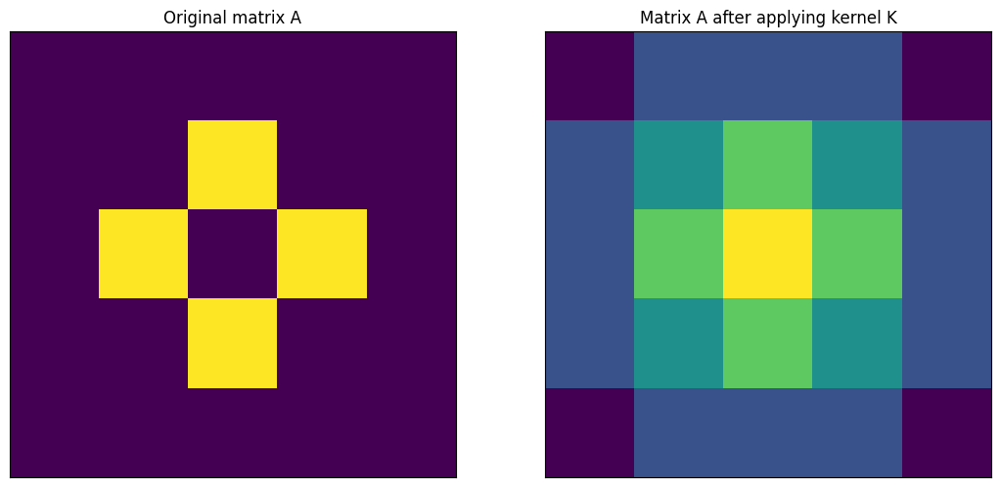

In [6]:
convoluted_matrix  = perform_same_convolution(matA, kerK)

plt.subplot(131), plt.imshow(matA), plt.title('Original matrix A'), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(convoluted_matrix), plt.title('Matrix A after applying kernel K'), plt.xticks([]), plt.yticks([])
plt.show()

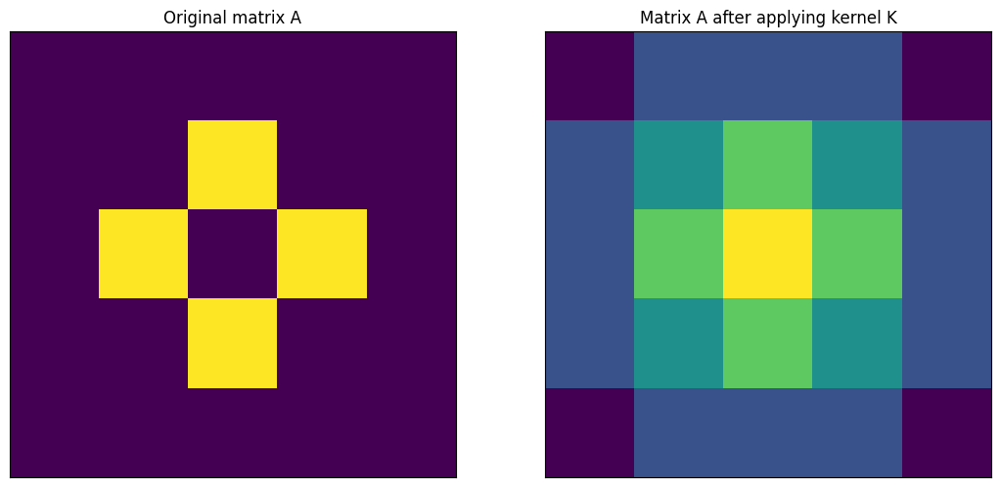

In [7]:
import scipy.signal as signal

convoluted_matrix = signal.convolve2d(matA, kerK, mode='same')

plt.subplot(131), plt.imshow(matA), plt.title('Original matrix A'), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(convoluted_matrix), plt.title('Matrix A after applying kernel K'), plt.xticks([]), plt.yticks([])
plt.show()

In [8]:
print('original matrix A')
print(matA / np.sum(matA))
print()
print()

print('matrix A after applying kernel K')
print(convoluted_matrix / np.sum(convoluted_matrix))


original matrix A
[[0.   0.   0.   0.   0.  ]
 [0.   0.   0.25 0.   0.  ]
 [0.   0.25 0.   0.25 0.  ]
 [0.   0.   0.25 0.   0.  ]
 [0.   0.   0.   0.   0.  ]]


matrix A after applying kernel K
[[0.         0.02777778 0.02777778 0.02777778 0.        ]
 [0.02777778 0.05555556 0.08333333 0.05555556 0.02777778]
 [0.02777778 0.08333333 0.11111111 0.08333333 0.02777778]
 [0.02777778 0.05555556 0.08333333 0.05555556 0.02777778]
 [0.         0.02777778 0.02777778 0.02777778 0.        ]]


**b.** How does the output matrix compare to the original image matrix $A$? 

What type of filter is kernel $K$ acting as? 
Alternatively, if you divide the output image by `np.sum(kerK)`, what have you essentially done to the image?

**Answer:** 

It is a box or an averaging filter. It smoother the image by averaging the pixel values in the neighborhood of each pixel.

**c.** Let matrix $O_1$ be the output from the 2D convolution between image matrix $MatC$ and kernel $KerC$. Compute $O_1$. 

The same way that we write out $C$ and $D$ for you, write out the output for us as a **NumPy array**, as in output the matrix $O_1$. You may choose to write out the full convolution (by zero-padding image matrix $C$ and then convolving with kernel $D$) or simply crop the output matrix to be the same size as the input matrix.

In [9]:
# Create image matrix C.
matC = np.zeros((5, 5))
matC[:,[1,3]] = 1

matC

array([[0., 1., 0., 1., 0.],
       [0., 1., 0., 1., 0.],
       [0., 1., 0., 1., 0.],
       [0., 1., 0., 1., 0.],
       [0., 1., 0., 1., 0.]])

In [10]:
# Create filter kernel C.
kerC = np.array([-1, 0, 1])
kerC = np.expand_dims(kerC, 0)

kerC

array([[-1,  0,  1]])

In [11]:
def convolution_2d(image, kernel):
    kernel_height, kernel_width = kernel.shape
    image_height, image_width = image.shape

    # Padding the image
    padded_image = np.pad(image, ((kernel_height // 2, kernel_height // 2),
                                   (kernel_width // 2, kernel_width // 2)),
                          mode='constant', constant_values=0)

    # Create an empty array to store the result
    convolved_image = np.zeros_like(image)

    # Flip the kernel for convolution
    flipped_kernel = np.flipud(np.fliplr(kernel))

    # Perform convolution
    for i in range(image_height):
        for j in range(image_width):
            convolved_image[i, j] = np.sum(
                padded_image[i:i + kernel_height, j:j + kernel_width] * flipped_kernel)

    return convolved_image

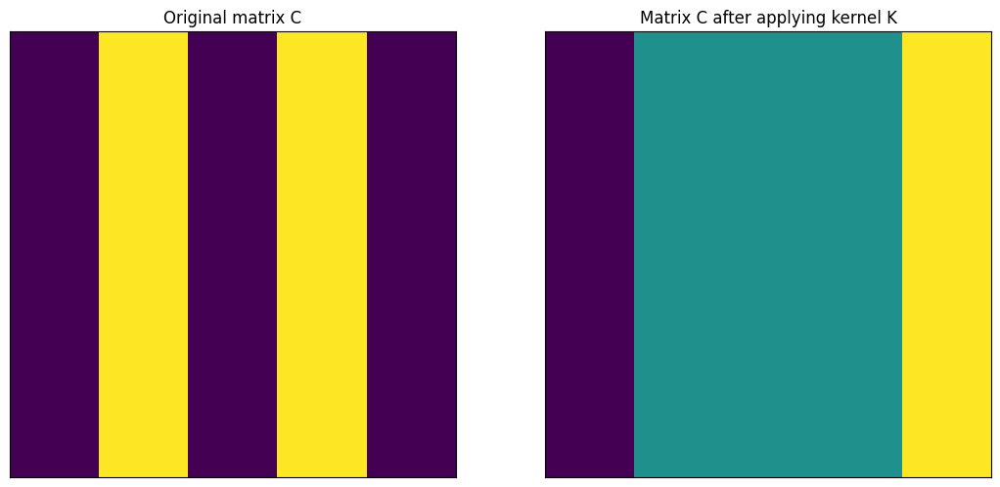

In [12]:
O1 = signal.convolve2d(matC, kerC, mode='same')

plt.subplot(131), plt.imshow(matC), plt.title('Original matrix C'), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(O1), plt.title('Matrix C after applying kernel K'), plt.xticks([]), plt.yticks([])
plt.show()

**d.** How does the output matrix $O$ compare to the original image matrix $C$?  
In other words, what kind of a filter is kernel $C$?

**Answer:** YOUR WRITTEN ANSWER TO QUESTION 1d HERE  

**e.** Convolve image matrix $C$ with kernel $kerE$ to get matrix $O2$. How does $kerE$ differ from $kerC$?  
Try this first by hand, to get a deeper understanding of the process.

In [13]:
# Create filter kernel Ec
kerE = kerC.T

kerE

array([[-1],
       [ 0],
       [ 1]])

In [14]:
O2 = signal.convolve2d(matC, kerE, mode='same')
O2

array([[ 0., -1.,  0., -1.,  0.],
       [ 0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.],
       [ 0.,  1.,  0.,  1.,  0.]])

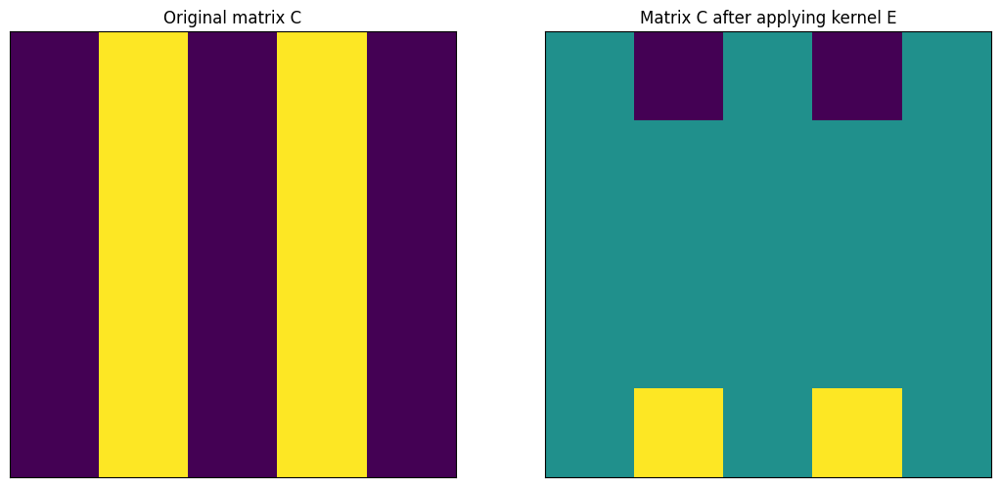

In [15]:

plt.subplot(131), plt.imshow(matC), plt.title('Original matrix C'), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(O2), plt.title('Matrix C after applying kernel E'), plt.xticks([]), plt.yticks([])

plt.show()


**Answer:** YOUR WRITTEN ANSWER TO QUESTION 1e HERE  

**f.** Import your favorite image as a NumPy array. Try to keep it reasonably sized (like 256-by-256) to avoid overly long computation times. If you don’t have a favorite image, you can create a matrix of zeros and ones to form shapes (such as a disk or rectangle).

Apply some additive white Gaussian noise to your image. There are many ways to do this (google it 😉) ), and you should choose your favorite method!  
Next, try to smooth out your noisy image using your favorite linear [smoothing filter](https://docs.opencv.org/3.4/dc/dd3/tutorial_gausian_median_blur_bilateral_filter.html).

Show all three images (the original image, the noisy image, and the smoothed noisy image) side-by-side using `plt.subplots()`.

Play around with the level of noise as well as the smoothing filter parameters.  
At what level of noise can you no longer distinguish the main features of the original image? 

As the level of noise increases, how should you adjust your smoothing filter parameters? What is the main downside to smoothing images?


In [16]:
def apply_gausian_noise(image: np.array, sigma: float) -> np.array:
    noise = np.random.normal(0, sigma, image.shape)
    image =  image + noise
    return np.clip(image, 0, 255).astype(np.uint8)

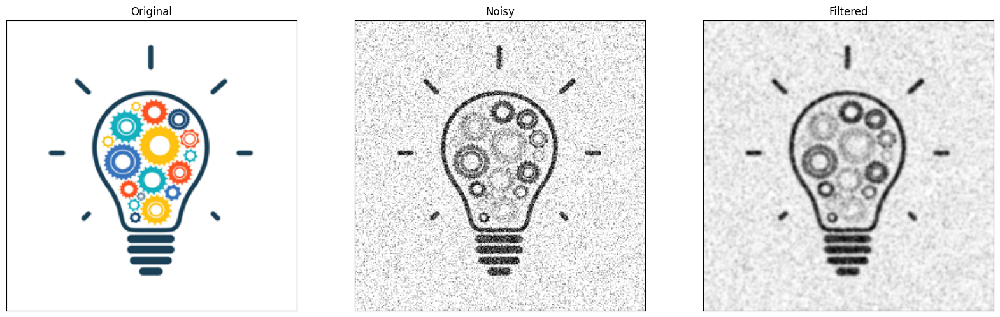

In [17]:
image_src: str = "image copy.png"
image = np.array(Image.open(image_src).resize((256,256)))
image_gray = image[:,:,1]

noisy_image = apply_gausian_noise(image_gray, 50)
filtered_image = cv2.GaussianBlur(src=noisy_image,  ksize=(5,5), sigmaX=1)

plt.subplot(131), plt.imshow(image), plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(noisy_image, cmap='gray'), plt.title('Noisy'), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(filtered_image, cmap='gray'), plt.title('Filtered'), plt.xticks([]), plt.yticks([])


plt.show()

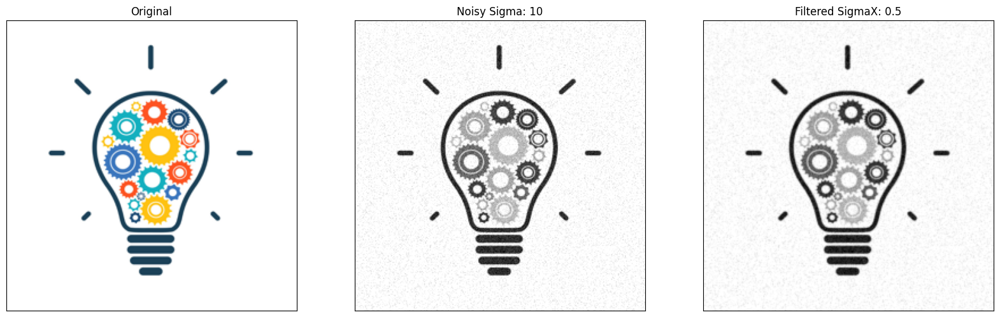

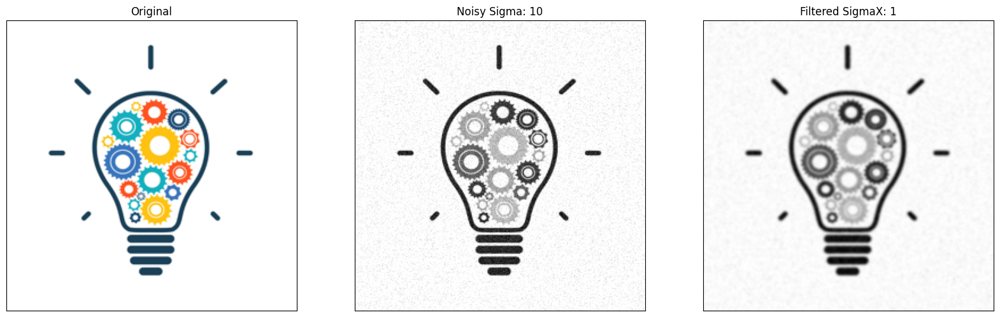

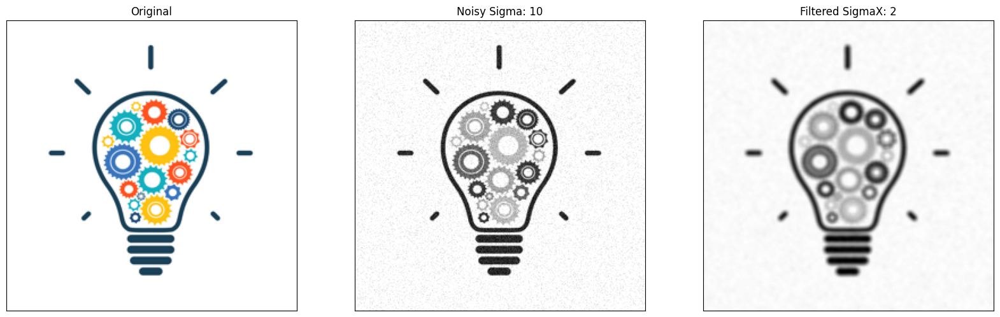

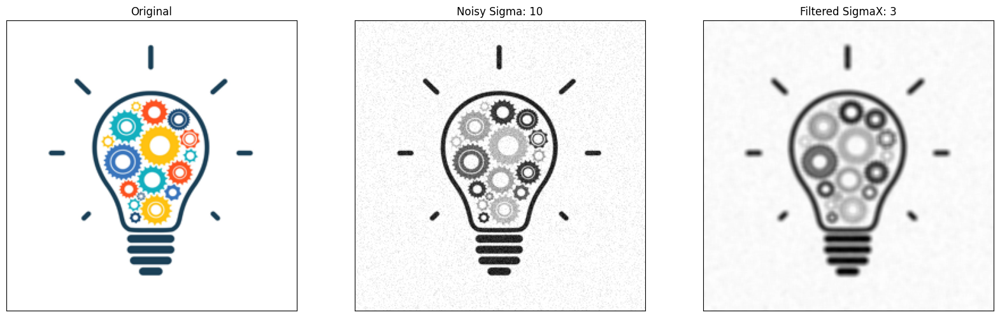

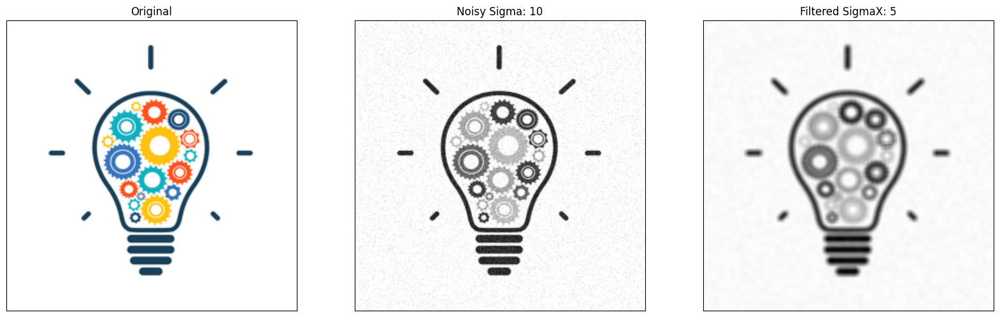

...

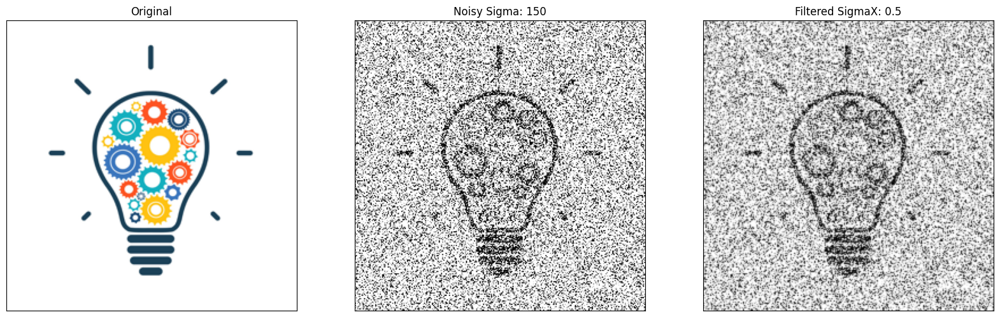

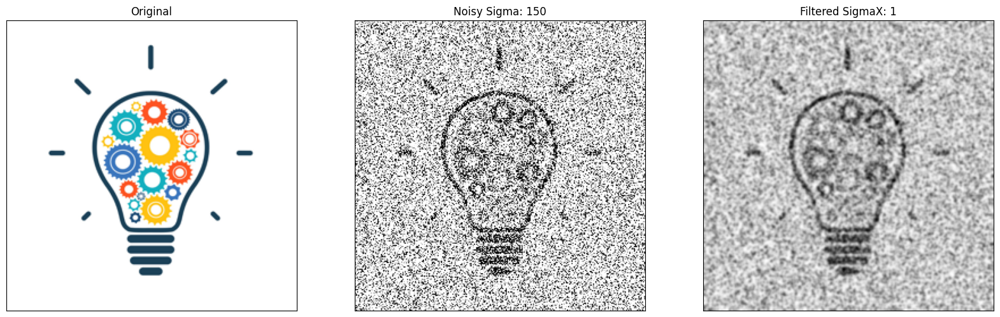

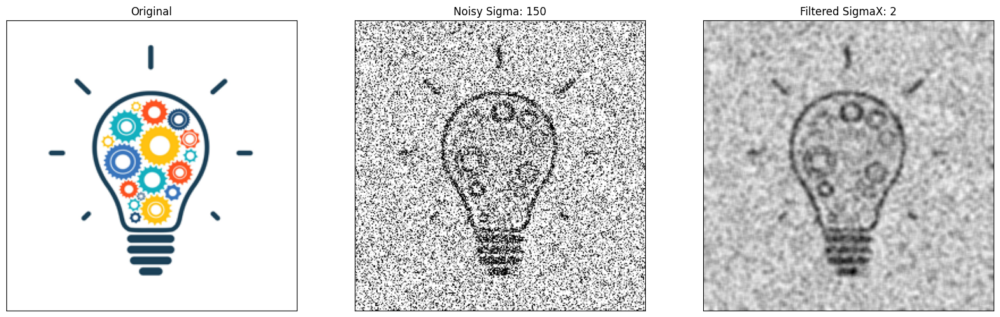

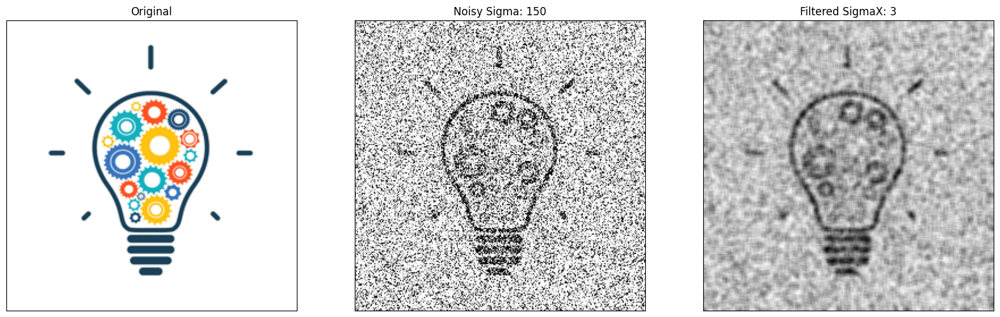

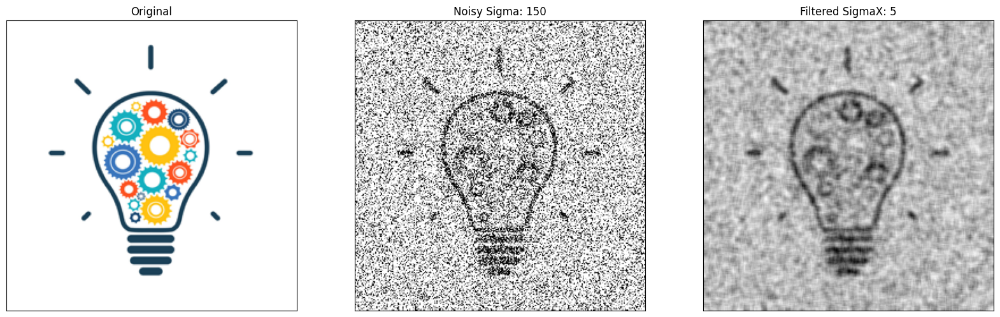

In [18]:
# I also want to try all the filters i found in the cv2 library
image = np.array(Image.open(image_src).resize((256,256)))
image_gray = image[:,:,1]

for sigma in [10, 50, 100, 150]:
    for sigmaX in [0.5, 1, 2, 3, 5]:
        noisy_image = apply_gausian_noise(image_gray, sigma)
        filtered_image = cv2.GaussianBlur(src=noisy_image, ksize=(5,5), sigmaX=sigmaX)
        plt.subplot(131), plt.imshow(image), plt.title('Original'),plt.xticks([]), plt.yticks([])
        plt.subplot(132), plt.imshow(noisy_image, cmap='gray'), plt.title(f'Noisy Sigma: {sigma}'),plt.xticks([]), plt.yticks([])
        plt.subplot(133), plt.imshow(filtered_image, cmap='gray'), plt.title(f'Filtered SigmaX: {sigmaX}'), plt.xticks([]), plt.yticks([])
        plt.show()

**Answer:** 
* When applying gausian noise all values for sigma over 100 are creating too much noise that is not possible to distinguish the main features of the original image.
* Also very high values for smoothing, over 1, are not good because the image is becoming too blurry and the main features are not distinguishable. For example it is not anymore possible to distinguish that there are gears inside the lamp, as they look like a circle.

**g.** Try applying a linear edge detection kernel (such as a [central finite difference kernel](https://stackoverflow.com/questions/26694704/2d-image-convolution-central-difference-on-x-gradient) or Sobel operator) to both your original image and the noisy image. How does it do?

In [19]:
central_fonited_difference = np.array([
    [0, 0, 0],
    [-1, 0, 1],
    [0, 0, 0]
])
prewitt = np.array([
    [-1, 0, 1], 
    [-1, 0, 1], 
    [-1, 0, 1]
])
sobel = np.array([
    [-1, 0, 1], 
    [-2, 0, 2], 
    [-1, 0, 1]
])

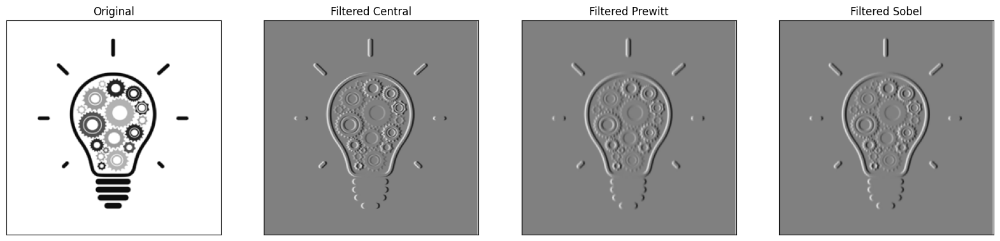

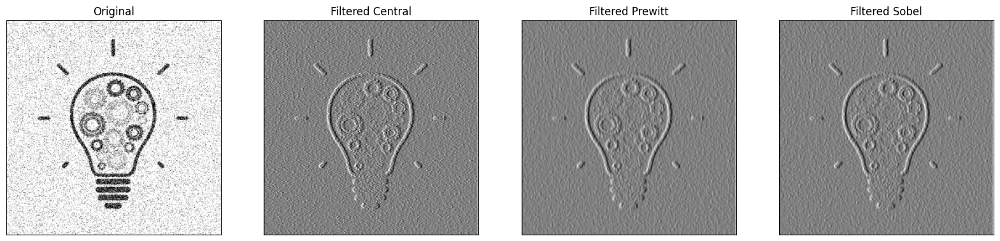

In [20]:
image = np.array(Image.open("image copy.png").resize((256,256)))
image_gray = image[:,:,1]

filtered_image_central = signal.convolve2d(image_gray, central_fonited_difference, mode='same')
filtered_image_prewitt = signal.convolve2d(image_gray, prewitt, mode='same')
filtered_image_sobel = signal.convolve2d(image_gray, sobel, mode='same')

plt.subplot(141), plt.imshow(image_gray, cmap='gray'), plt.title('Original'),  plt.xticks([]), plt.yticks([])
plt.subplot(142), plt.imshow(filtered_image_central, cmap='gray'), plt.title('Filtered Central'), plt.xticks([]), plt.yticks([])
plt.subplot(143), plt.imshow(filtered_image_prewitt, cmap='gray'), plt.title('Filtered Prewitt'), plt.xticks([]), plt.yticks([])
plt.subplot(144), plt.imshow(filtered_image_sobel, cmap='gray'), plt.title('Filtered Sobel'), plt.xticks([]), plt.yticks([])
plt.show()

noisy_image = apply_gausian_noise(image_gray, 50)
filtered_image_central = signal.convolve2d(noisy_image, central_fonited_difference, mode='same')
filtered_image_prewitt = signal.convolve2d(noisy_image, prewitt, mode='same')
filtered_image_sobel = signal.convolve2d(noisy_image, sobel, mode='same')

plt.subplot(141), plt.imshow(noisy_image, cmap='gray'), plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(142), plt.imshow(filtered_image_central, cmap='gray'), plt.title('Filtered Central'), plt.xticks([]), plt.yticks([])
plt.subplot(143), plt.imshow(filtered_image_prewitt, cmap='gray'), plt.title('Filtered Prewitt'), plt.xticks([]), plt.yticks([])
plt.subplot(144), plt.imshow(filtered_image_sobel, cmap='gray'), plt.title('Filtered Sobel'), plt.xticks([]), plt.yticks([])
plt.show()

**Answer:** 
* In the original image it detects the image edges very well, only its not doing very well at the bottom of the light bulb, no clue how that part is called...
* In the noisy image it is also possible to distinguish the main features of the image, as the noise is not very high. But the edges are not as clear as in the original image. Additionally it detects all the noise as edges.
* Also Central finite difference kernel to me did the best job, as the edges are the shapest, but at the same time, with noise it is detecting the most edges, and makes the biggest mess.

**h.** Linear [smoothing filters](https://docs.opencv.org/3.4/d4/d13/tutorial_py_filtering.html) are an efficient way to reduce the presence of noise in the image at the cost of lowering image resolution and blurring out edges. Several *non*-linear filters were developed to both reduce noise while attempting to preserve the high frequency edges in the image.  
Choose a *non*-linear de-noising filter and apply it to your noisy image from part
 
**f.** How well does it do compared to the image that was de-noised using a linear smoothing filter?

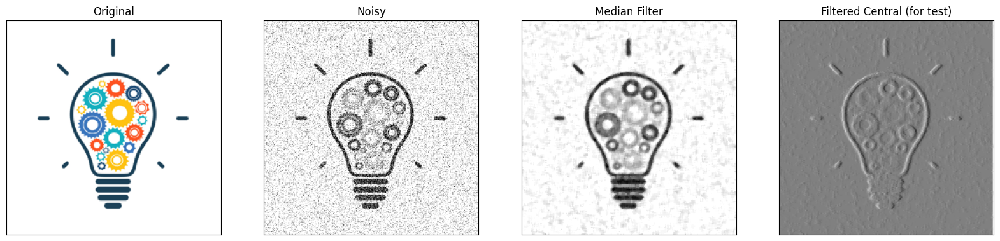

In [21]:
noisy_image = apply_gausian_noise(image_gray, 50)

# apply a non-linear filter
median_filter = cv2.medianBlur(noisy_image, 5)
filtered_image_central = signal.convolve2d(median_filter, central_fonited_difference, mode='same')

plt.subplot(141), plt.imshow(image, cmap='gray'), plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(142), plt.imshow(noisy_image, cmap='gray'), plt.title('Noisy'), plt.xticks([]), plt.yticks([])
plt.subplot(143), plt.imshow(median_filter, cmap='gray'), plt.title('Median Filter'),   plt.xticks([]), plt.yticks([])
plt.subplot(144), plt.imshow(filtered_image_central, cmap='gray'), plt.title('Filtered Central (for test)'), plt.xticks([]), plt.yticks([])
plt.show()

**Answer:** 
* the biggest change for me is the fact that we lost much noise in the white background, also the inside of the light bulb is much clearer,
* however the edges are not as sharp as in the linear smoothing filter, and the noise is still present, but not as much as in the original image.

## Problem 2: Geometric Features (25 points)

As you may know, the geometric features of a tumor can sometimes reveal significant information about whether it is benign or malignant. Radiologists frequently [assess the geometry of lesions in mammograms](https://www.sciencedirect.com/science/article/pii/S2211568413003872) when attempting to diagnose breast cancer.

In this exercise, we will attempt to explore some **quantitative** methods of differentiating between certain lesion shapes.

Download the two mammograms from Teams Files. [`LEFT_CC_BENIGN.tif`](https://imcfhkrems.sharepoint.com/:i:/r/teams/LV_66620/Freigegebene%20Dokumente/General/Exercise%202/LEFT_CC_BENIGN.tif?csf=1&web=1&e=1qOdKn) depicts a cranial-caudal view (looking down on the breast from the patient's perspective) of the left breast. There is a benign lesion present in the mammogram. Can you locate it? 

If you are having difficulty locating the lesion, try seeing if you can spot it in the mask [`LEFT_CC_BENIGN_MASK.tif`](https://imcfhkrems.sharepoint.com/:i:/r/teams/LV_66620/Freigegebene%20Dokumente/General/Exercise%202/LEFT_CC_BENIGN_MASK.tif?csf=1&web=1&e=kf8uUt), which consists of a rough segmentation of the lesion. [`RIGHT_CC_MALIGNANT.tif`](https://imcfhkrems.sharepoint.com/:i:/r/teams/LV_66620/Freigegebene%20Dokumente/General/Exercise%202/RIGHT_CC_MALIGNANT.tif?csf=1&web=1&e=jdFP9X) and [`RIGHT_CC_MALIGNANT_MASK.tif`](https://imcfhkrems.sharepoint.com/:i:/r/teams/LV_66620/Freigegebene%20Dokumente/General/Exercise%202/RIGHT_CC_MALIGNANT_MASK.tif?csf=1&web=1&e=dJTJ0n) are the mammogram and corresponding lesion segmentation of a different patient, but this mammogram depicts a breast with a **malignant** tumor.

**a.** Start by loading these two mammograms and their corresponding masks as image matrices. 
Plot them on a single figure (e.g., using a 2-by-2 grid of subplots, or merge the mask as a semi transparent/colored layer). You should use reasonable **x** and **y** limits in your figures to get a reasonable depiction of your lesion segmentations.

Qualitatively describe the shape differences between the two lesions. What types of shapes and margins are indicative of malignant tumors?

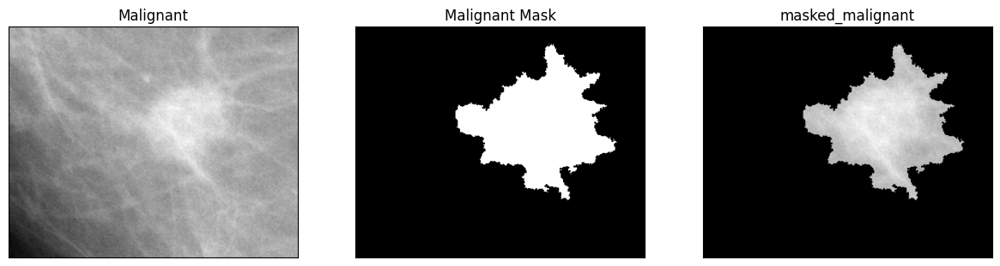

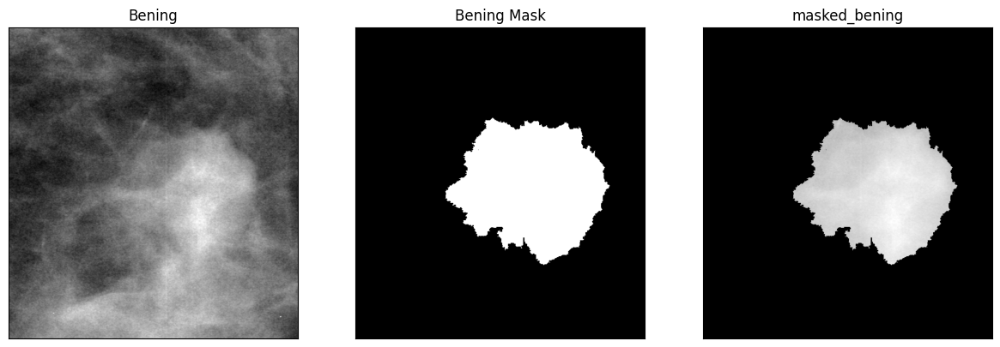

In [22]:
bening = Image.open("LEFT_CC_BENIGN.tif")
bening_numpy = np.array(bening)
bening_mask = Image.open("LEFT_CC_BENIGN_MASK.tif")
bening_mask_numpy = np.array(bening_mask)
malignant = Image.open("RIGHT_CC_MALIGNANT.tif")
malignant_numpy = np.array(malignant)
malignant_mask = Image.open("RIGHT_CC_MALIGNANT_MASK.tif")
malignant_mask_numpy = np.array(malignant_mask)

# merge the mask with the image
# bening_numpy = cv2.bitwise_and(bening_numpy, bening_numpy, mask=bening_mask_numpy)
# malignant_numpy = cv2.bitwise_and(malignant_numpy, malignant_numpy, mask=malignant_mask_numpy)

# plt.subplot(141), plt.imshow(bening_numpy, cmap='gray'), plt.title('Bening')
# plt.subplot(142), plt.imshow(malignant_numpy, cmap='gray'), plt.title('Malignant')

# plt.show()
extracted_malignant = malignant_numpy[3100:3500, 1100:1600]
extracted_malignant_mask = malignant_mask_numpy[3100:3500, 1100:1600]
masked_malignant = cv2.bitwise_and(extracted_malignant, extracted_malignant, mask=extracted_malignant_mask)
plt.subplot(141), plt.imshow(extracted_malignant, cmap='gray'), plt.title('Malignant'), plt.xticks([]), plt.yticks([])
plt.subplot(142), plt.imshow(extracted_malignant_mask, cmap='gray'), plt.title('Malignant Mask'), plt.xticks([]), plt.yticks([])
plt.subplot(143), plt.imshow(masked_malignant, cmap='gray'), plt.title('masked_malignant'), plt.xticks([]), plt.yticks([])
plt.show()


extracted_benign = bening_numpy[2200:2900, 1100:1750]
extracted_benign_mask = bening_mask_numpy[2200:2900, 1100:1750]
masked_beign = cv2.bitwise_and(extracted_benign, extracted_benign, mask=extracted_benign_mask)
plt.subplot(141), plt.imshow(extracted_benign, cmap='gray'), plt.title('Bening'), plt.xticks([]), plt.yticks([])
plt.subplot(142), plt.imshow(extracted_benign_mask, cmap='gray'), plt.title('Bening Mask'), plt.xticks([]), plt.yticks([])
plt.subplot(143), plt.imshow(masked_beign, cmap='gray'), plt.title('masked_bening'), plt.xticks([]), plt.yticks([])
plt.show()

# masked_img = cv2.bitwise_and(bening_numpy,bening_numpy,mask = bening_mask_numpy)

# plt.subplot(121), plt.imshow(bening_numpy, cmap='gray'), plt.title('Bening'), plt.xticks([]), plt.yticks([])
# plt.subplot(122), plt.imshow(masked_img, cmap='gray'), plt.title('Bening Masked'), plt.xticks([]), plt.yticks([])
# plt.show()



**Answer:** 
* we can see that bening has a more round shape
* on the oter hand the malignant has a more irregular shape, and the margins are not as clear as in the bening one.

**b.** Next, try computing some basic geometric features of the two lesions. Which features are the most significant for differentiating between them? Is this what you expected? The [`regionprops()`](https://scikit-image.org/docs/stable/auto_examples/segmentation/plot_regionprops.html) function in the `skimage` library will automatically compute several geometric features for you, but you might choose to code up some of your own. If you don't trust the provided segmentations, feel free to create your segmentation method or modify the provided ones to get a better estimate of the lesion shapes!  
Finally, it could be interesting to apply some edge-detection filters to the mammograms to better emphasize the margins. 

You can also test your approach on other mammograms from a [larger dataset (~20 GB)](https://imcfhkrems.sharepoint.com/:f:/r/teams/LV_62825/Class%20Materials/Exercise%202?csf=1&web=1&e=X41LBH). You will need these mammograms for the next problem set (deep-learning), so there's no harm in downloading the images now!

**There is no single correct answer for this exercise, and you should definitely try several different approaches and explore!**

In [23]:
malignant_stats = regionprops(extracted_malignant_mask, extracted_malignant)
benign_stats = regionprops(extracted_benign_mask, extracted_benign)

# Which properties are you interested in to compare the two tumors?
# Roundness

# Calculate the roundness of the tumor
def calculate_roundness(stats):
    return 4 * np.pi * stats[0].area / (stats[0].perimeter ** 2)

malignant_roundness = calculate_roundness(malignant_stats)
benign_roundness = calculate_roundness(benign_stats)

print(f"""
Malignant Roundness: {malignant_roundness}
Benign Roundness: {benign_roundness}
Malignant Area: {malignant_stats[0].area}
Benign Area: {benign_stats[0].area}
Malignant Perimeter: {malignant_stats[0].perimeter}
Benign Perimeter: {benign_stats[0].perimeter}
""")


Malignant Roundness: 0.19850342359400897
Benign Roundness: 0.3455867336700358
Malignant Area: 35508.0
Benign Area: 79149.0
Malignant Perimeter: 1499.2844507162113
Benign Perimeter: 1696.481456229631



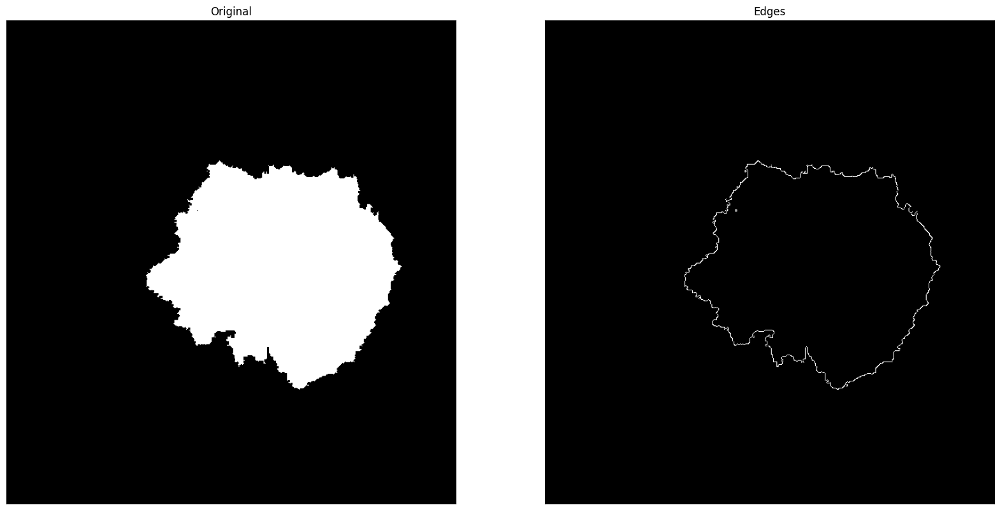

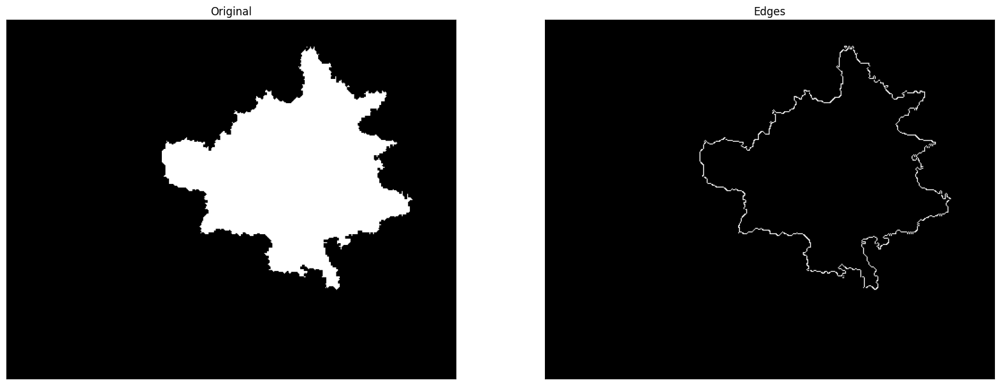

In [24]:
# apply cannys edge detection
edges_bening = cv2.Canny(extracted_benign_mask.astype(np.uint8), 50, 150)

plt.subplot(121), plt.imshow(extracted_benign_mask, cmap='gray'), plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(edges_bening, cmap='gray'), plt.title('Edges'), plt.xticks([]), plt.yticks([])
plt.show()

edges_malignant = cv2.Canny(extracted_malignant_mask.astype(np.uint8), 50, 150)

plt.subplot(121), plt.imshow(extracted_malignant_mask, cmap='gray'), plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(edges_malignant, cmap='gray'), plt.title('Edges'), plt.xticks([]), plt.yticks([])
plt.show()

Image: malignant.png


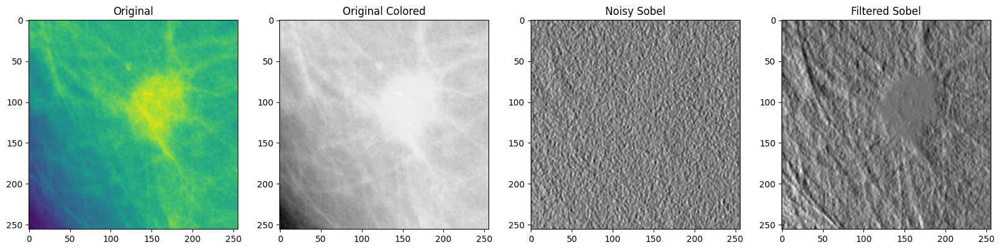

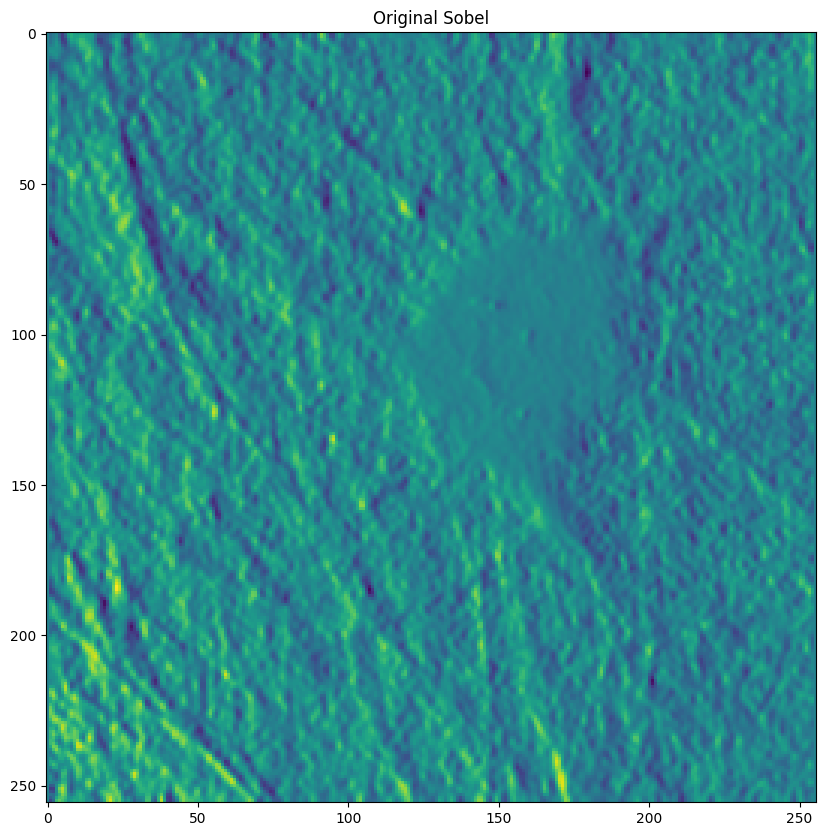

Image: benign.png


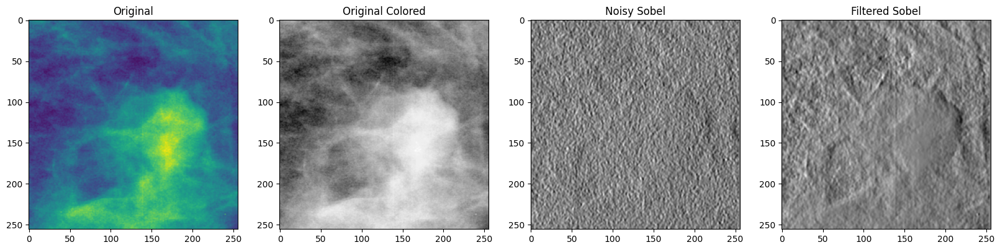

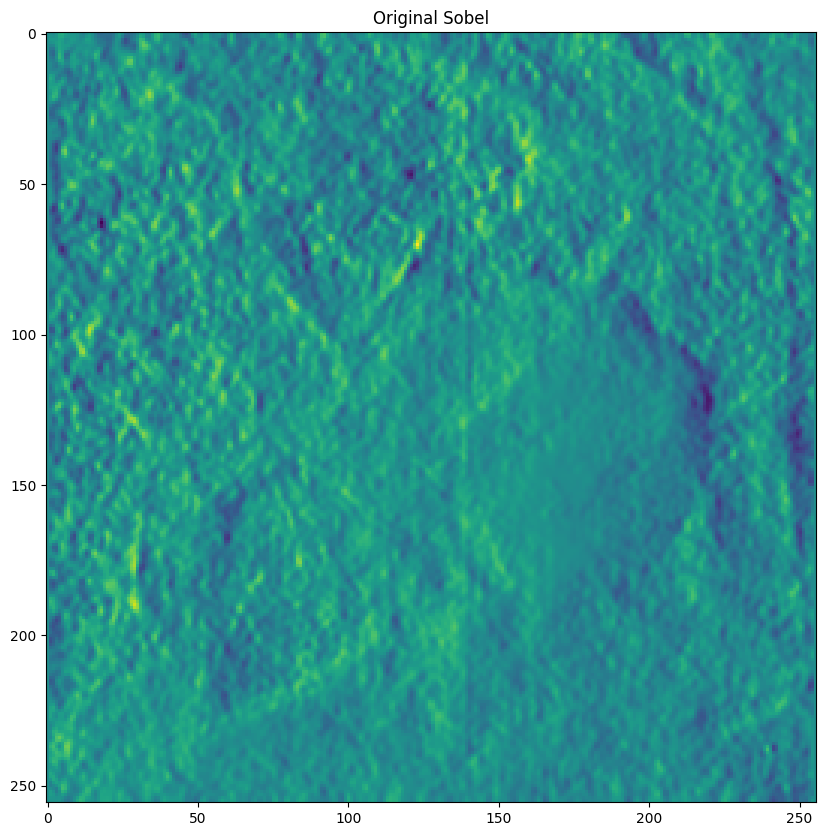

In [30]:
plt.imsave("malignant.png", extracted_malignant, cmap='viridis')
plt.imsave("benign.png", extracted_benign, cmap='viridis')
# Apply sobel
image_malignant = "malignant.png"
image_benign = "benign.png"


for i in [image_malignant, image_benign]:
    temp_image = np.array(Image.open(i).resize((256,256)))

    noisy_image =  apply_gausian_noise(temp_image, 25)
    filtered_image = cv2.medianBlur(temp_image, 5)

    print(f"Image: {i}")
    noisy_image_colored = cv2.cvtColor(noisy_image, cv2.COLOR_BGR2GRAY)
    filtered_image_colored = cv2.cvtColor(filtered_image, cv2.COLOR_BGR2GRAY)
    image_colored = cv2.cvtColor(temp_image, cv2.COLOR_BGR2GRAY)


    sobel_colored = cv2.Sobel(image_colored, cv2.CV_64F, 1, 0, ksize=5)
    sobel_noisy = cv2.Sobel(noisy_image_colored, cv2.CV_64F, 1, 0, ksize=5)
    # sobel_filtered = cv2.Sobel(filtered_image_colored, cv2.CV_64F, 1, 0, ksize=5)
    sobel_filtered = cv2.Sobel(temp_image, cv2.CV_64F, 1, 0, ksize=5)

    # plot original, original colored, noisy sobel, filtered sobel
    plt.subplot(141), plt.imshow(temp_image), plt.title('Original')
    plt.subplot(142), plt.imshow(image_colored, cmap='gray'), plt.title('Original Colored')
    plt.subplot(143), plt.imshow(sobel_noisy, cmap='gray'), plt.title('Noisy Sobel')
    plt.subplot(144), plt.imshow(sobel_colored, cmap='gray'), plt.title('Filtered Sobel')

    plt.show()

    plt.imshow(sobel_colored, cmap='viridis'), plt.title('Original Sobel')
    plt.show()


## Problem 3: Tumor Classification (50 Points)

In addition to the [mammograms themselves (~20 GB)](https://imcfhkrems.sharepoint.com/:f:/r/teams/LV_62825/Class%20Materials/Exercise%202?csf=1&web=1&e=X41LBH), which is based on [this](https://wiki.cancerimagingarchive.net/display/Public/CBIS-DDSM), the dataset includes "ground-truth" segmentations and [`mass_case_description_train_set.csv`](https://imcfhkrems.sharepoint.com/:x:/r/teams/LV_66620/Freigegebene%20Dokumente/General/Exercise%202/mass_case_description_train_set.csv?d=w9374d8e3fcf14429951211d33860a248&csf=1&web=1&e=Gz5jKL), which contains metadata information about mass shapes, mass margins, assessment numbers, pathology diagnoses, and subtlety in the data. Take some time to research what all of these different fields mean and how you might utilize them in your work. Note that you don't need to use all of what is provided to you...

Here are some ideas:

1. Use the ROI’s or segmentations to extract features, and then train a classifier based on these feature table using the algorithms presented to you last year in the machine learning lectures (it doesn't have to be with deep learning).

2. Use Convolutional Neural Networks (CNNs). Feel free to use any framework or package (sklearn, pytorch, pytorch-lightning, timm, keras, Tensorflow, etc.), or create your own custom code. If you dont want to place helper functions and classes into this notebook, place them in a `.py` file in the same folder and import them into this notebook (careful not to use reserved words for this).

**a.** The delivery should be a report which includes the experiment planning, the extracted features and the results.
Try answering in your report the following questions:
- Which method(s) did you use? 
- Why did you choose these method(s)?
- What were your expectations towards these methods?
- Which method worked the best for you? Which method worked the worst? Can you think why?
- How did they perform compared to your expectations?
- Which metrics did you use? To which ones did you pay the most attention?
- How do you feel about your results? 
- How would you plan to improve your results further?  

**b.** Prepare a **presentation** based on your report, and be prepared to present your experiments and your results to the rest of the class on our upcoming session.

Please submit your slides (also possible as an exported PDF).

In [32]:
### WRITE CODE IN HERE. You can have up to 5 cells for this question ################################






import pandas as pd

df = pd.read_csv("mass_case_description_train_set.csv")
df







######################################################################################################

,patient_id,breast_density,left or right breast,image view,abnormality id,abnormality type,mass shape,mass margins,assessment,pathology,subtlety,image file path,cropped image file path,ROI mask file path
0,P_00001,3,LEFT,CC,1,mass,IRREGULAR-ARCHITECTURAL_DISTORTION,SPICULATED,4,MALIGNANT,4,Mass-Training_P_00001_LEFT_CC/1.3.6.1.4.1.9590...,Mass-Training_P_00001_LEFT_CC_1/1.3.6.1.4.1.95...,Mass-Training_P_00001_LEFT_CC_1/1.3.6.1.4.1.95...
1,P_00001,3,LEFT,MLO,1,mass,IRREGULAR-ARCHITECTURAL_DISTORTION,SPICULATED,4,MALIGNANT,4,Mass-Training_P_00001_LEFT_MLO/1.3.6.1.4.1.959...,Mass-Training_P_00001_LEFT_MLO_1/1.3.6.1.4.1.9...,Mass-Training_P_00001_LEFT_MLO_1/1.3.6.1.4.1.9...
2,P_00004,3,LEFT,CC,1,mass,ARCHITECTURAL_DISTORTION,ILL_DEFINED,4,BENIGN,3,Mass-Training_P_00004_LEFT_CC/1.3.6.1.4.1.9590...,Mass-Training_P_00004_LEFT_CC_1/1.3.6.1.4.1.95...,Mass-Training_P_00004_LEFT_CC_1/1.3.6.1.4.1.95...
3,P_00004,3,LEFT,MLO,1,mass,ARCHITECTURAL_DISTORTION,ILL_DEFINED,4,BENIGN,3,Mass-Training_P_00004_LEFT_MLO/1.3.6.1.4.1.959...,Mass-Training_P_00004_LEFT_MLO_1/1.3.6.1.4.1.9...,Mass-Training_P_00004_LEFT_MLO_1/1.3.6.1.4.1.9...
4,P_00004,3,RIGHT,MLO,1,mass,OVAL,CIRCUMSCRIBED,4,BENIGN,5,Mass-Training_P_00004_RIGHT_MLO/1.3.6.1.4.1.95...,Mass-Training_P_00004_RIGHT_MLO_1/1.3.6.1.4.1....,Mass-Training_P_00004_RIGHT_MLO_1/1.3.6.1.4.1....
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1313,P_02033,2,RIGHT,MLO,1,mass,IRREGULAR,ILL_DEFINED,3,MALIGNANT,4,Mass-Training_P_02033_RIGHT_MLO/1.3.6.1.4.1.95...,Mass-Training_P_02033_RIGHT_MLO_1/1.3.6.1.4.1....,Mass-Training_P_02033_RIGHT_MLO_1/1.3.6.1.4.1....
1314,P_02079,2,RIGHT,CC,1,mass,ROUND,SPICULATED,3,MALIGNANT,5,Mass-Training_P_02079_RIGHT_CC/1.3.6.1.4.1.959...,Mass-Training_P_02079_RIGHT_CC_1/1.3.6.1.4.1.9...,Mass-Training_P_02079_RIGHT_CC_1/1.3.6.1.4.1.9...
1315,P_02079,2,RIGHT,MLO,1,mass,ROUND,SPICULATED,3,MALIGNANT,5,Mass-Training_P_02079_RIGHT_MLO/1.3.6.1.4.1.95...,Mass-Training_P_02079_RIGHT_MLO_1/1.3.6.1.4.1....,Mass-Training_P_02079_RIGHT_MLO_1/1.3.6.1.4.1....
1316,P_02092,2,LEFT,CC,1,mass,IRREGULAR,SPICULATED,3,MALIGNANT,2,Mass-Training_P_02092_LEFT_CC/1.3.6.1.4.1.9590...,Mass-Training_P_02092_LEFT_CC_1/1.3.6.1.4.1.95...,Mass-Training_P_02092_LEFT_CC_1/1.3.6.1.4.1.95...


In [34]:
for col in df.columns[1:]:
    df[col].value_counts()

patient_id                 object
breast_density              int64
left or right breast       object
image view                 object
abnormality id              int64
abnormality type           object
mass shape                 object
mass margins               object
assessment                  int64
pathology                  object
subtlety                    int64
image file path            object
cropped image file path    object
ROI mask file path         object
dtype: object